In [1]:
from mu2e import mu2e_ext_path
from mu2e.dataframeprod import g4root_to_df
from root_pandas import read_root
import pandas as pd
from mu2e.mu2eplots import mu2e_plot3d_ptrap
from mu2e.mu2eplots import mu2e_plot3d_ptrap_traj
from mu2e.mu2eplots import mu2e_plot3d_ptrap_anim
import mu2e.mu2eplots as mplt
import six.moves.cPickle as pkl
%matplotlib inline
plt.rcParams['figure.figsize'] = (12,8)
mu2e_data_path = '/Volumes/DataDump/Mu2E/'
from skhep.visual import MplPlotter as splt

Welcome to JupyROOT 6.10/04


/usr/local/lib/python3.6/site-packages/IPython/html.py:14: ShimWarning:

The `IPython.html` package has been deprecated since IPython 4.0. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.

/usr/local/Cellar/root/6.10.04/lib/root/ROOT.py:318: UserWarning:

IPython.utils.traitlets has moved to a top-level traitlets package.



<IPython.core.display.Javascript object>

In [5]:
df_ntpart_Mau13, _, _ = g4root_to_df(mu2e_data_path+'muon-r2-Mau13/nts.bpollack.iso_muons_Mau13_stage1_vd.v650p.combined',
do_basic_modifications=True, trees=['part'])
df_ntpart_Mau12, _, _ = g4root_to_df(mu2e_data_path+'muon-r2-Mau12/run2/nts.bpollack.iso_muons_Mau12_stage1_region2_vd.v650p.combined',
do_basic_modifications=True, trees=['part'])
# df_mu_rall = pd.read_pickle('mau12_700ns_v1.p')
# df_mu_rall.name = 'Muons (all region)'
#df_mu_r1 = pd.read_pickle('mau12_700ns_r1.p')
#df_mu_r1.name = 'Muons (Region 1)'
##df_mu_r2 = pd.read_pickle('mau12_700ns_r2.p')
##df_mu_r2.name = 'Muons (Region 2)'
#df_mu_r2a = pd.read_pickle('mau12_700ns_r2a.p')
#df_mu_r2a.name = 'Muons (Region 2a)'
#df_mu_r2b = pd.read_pickle('mau12_700ns_r2b.p')
#df_mu_r2b.name = 'Muons (Region 2b)'
#df_mu_r2brass = pd.read_pickle('mau12_700ns_r2brass.p')
#df_mu_r2brass.name = 'Muons (Region 2, brass)'
#df_mu_r2 = pd.concat([df_mu_r2a, df_mu_r2b], ignore_index=True)
#df_mu_r2.name= 'Muons (Region 2)'
#df_mu_r3 = pd.read_pickle('mau12_700ns_r3.p')
#df_mu_r3.name = 'Muons (Region 3)'
#df_mu_rall = pd.concat([df_mu_r1, df_mu_r2, df_mu_r3], ignore_index=True)
#df_mu_rall.name = 'Muons (all region)'

In [3]:
store_xray = pd.HDFStore(mu2e_data_path+'G4ParticleSim/low_e_ele_0T_v580.h5')
df_xray = store_xray.df_ntpart
store_xray.close()

In [15]:
# df_mu = df_ntpart.query('pdg==13 and tstop>700').reset_index()
# df_mu.name = 'Muons'
# df_mu.to_pickle('mau12_700ns_v1.p')

In [13]:
mu2e_plot3d_ptrap(df_ntpart_Mau13.query('pstop>75'),
                  'zstop','xstop','ystop', x_range=[3700,17500], y_range = [-1000,1000], z_range=[-1000,1000], save_name=None,
                   df_xray=df_xray, color='pstop', title='Muon position at t=700ns (permanent trap)')

binning...
binned


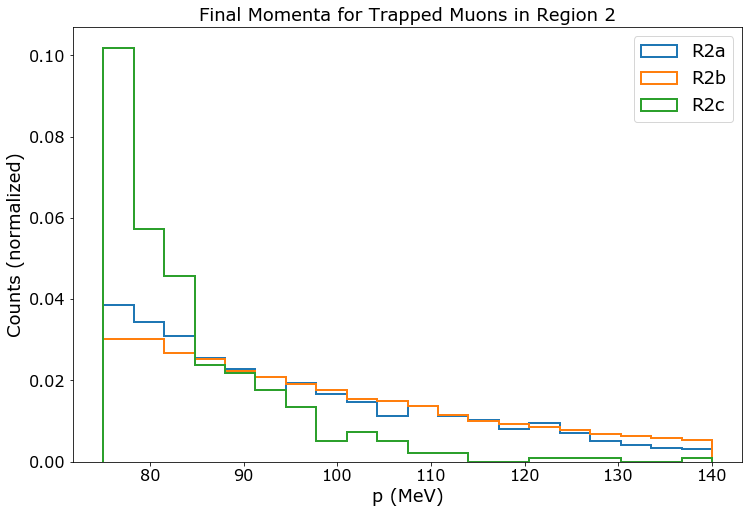

In [26]:
splt.hist(df_mu_r2.query('9700<zstop<10000').pstop, normed=True, range=(75,140), bins=20, histtype='step', label='R2a')
splt.hist(df_mu_r2.query('11570<zstop').pstop.values, normed=True, range=(75,140), bins=20, histtype='step', label='R2b')
splt.hist(df_mu_r2.query('10000<zstop<11570').pstop.values, normed=True, range=(75,140), bins=20, histtype='step', label='R2c')
plt.ylabel('Counts (normalized)')
plt.xlabel('p (MeV)')
plt.title('Final Momenta for Trapped Muons in Region 2')
plt.legend()

In [7]:
df_mu_single = df_nttvd_ft.query('runevt==23340830').sort_values('time')
#df_mu_single = pd.concat([df_mu_single[0:20], df_mu_single[-20:]])
df_mu_single.name = 'Muon'

df_mu_single2 = df_nttvd_ft.query('runevt==32013674').sort_values('time')
#df_mu_single = pd.concat([df_mu_single[0:20], df_mu_single[-20:]])
df_mu_single2.name = 'Muon'

df_mu_single3 = df_nttvd_ft.query('runevt==38884487').sort_values('time')
#df_mu_single = pd.concat([df_mu_single[0:20], df_mu_single[-20:]])
df_mu_single3.name = 'Muon'


In [8]:
df_tmp = df_mu_single3
df_tmp.name = 'Muon'
mu2e_plot3d_ptrap_traj(df_tmp,'z','x','y',df_xray=df_xray, aspect='default',
                        title='Trapped Muon Trajetory', color_mode='time')

binning...
binned


In [24]:
df_ntpart_ft.zstop.describe()

count      658.000000
mean     10318.815430
std        799.340088
min       7830.723633
25%       9870.022461
50%       9894.552246
75%      10551.999756
max      12101.110352
Name: zstop, dtype: float64

In [38]:
df_ntpart_ft.query('runevt==7657397').pstop

,run,subrun,evt,trk,pdg,time,gtime,x,y,z,...,parent_py,parent_pz,parent_p,parent_pxstop,parent_pystop,parent_pzstop,parent_pstop,parent_code,parent_lastke,runevt
0,1,0,66467,1,13,0.0,0.0,111.306152,587.386353,9871.666992,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,66467
1,1,1,44183,1,13,0.0,0.0,421.488525,662.968262,9753.467773,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,144183
2,1,2,35883,1,13,0.0,0.0,-478.307617,-48.959373,10407.639648,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,235883
3,1,3,95643,1,13,0.0,0.0,185.068848,233.731750,10505.537109,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,395643
4,1,4,6682,1,13,0.0,0.0,23.036133,-426.045898,10414.326172,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,46682
5,1,4,72952,1,13,0.0,0.0,740.326904,409.465790,9752.247070,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,472952
6,1,5,45429,1,13,0.0,0.0,-99.406738,-38.512825,9886.675781,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,545429
7,1,6,87542,1,13,0.0,0.0,-183.760010,-338.805450,10432.020508,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,687542
8,1,7,7384,1,13,0.0,0.0,294.908447,-505.230316,9900.292969,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,77384
9,1,7,13561,1,13,0.0,0.0,-128.803955,-421.364899,10088.953125,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,713561


In [39]:
df_mu_single = df_nttvd_ft.query('runevt==66467').sort_values('time')
df_mu_single.name = 'Muon'

In [18]:
df_mu_single.iloc[0:20].x.max()-df_mu_single.iloc[0:20].x.min()

825.69092

In [31]:

mu2e_plot3d_ptrap_traj(df_mu_single,'z','x','y',df_xray=df_xray, aspect='default',
                        title='Trapped Muon Trajetory', color_mode='time')

binning...
binned


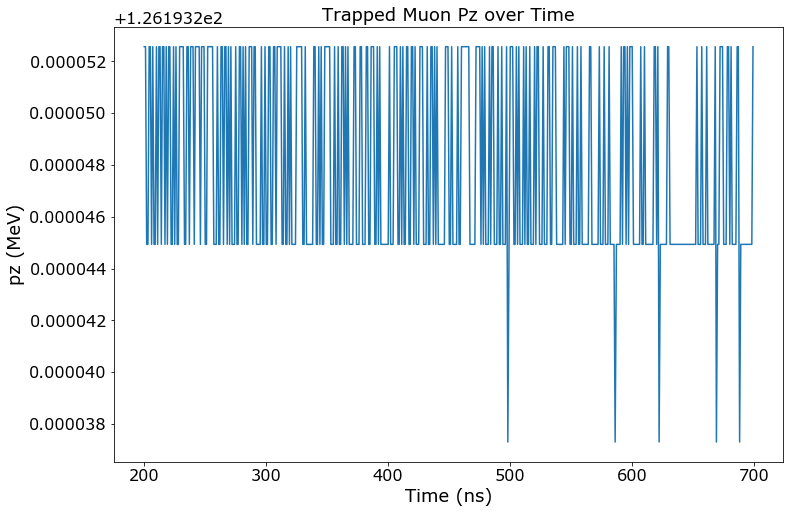

In [43]:
plt.plot(df_mu_single.time, df_mu_single.p)
plt.title('Trapped Muon Pz over Time')
plt.xlabel('Time (ns)')
plt.ylabel('pz (MeV)')

In [9]:
r2_cut = df_mu_r2.query('pstop>75')
r2_cut.name = 'Muons (Region 2)'
mu2e_plot3d_ptrap(r2_cut,
                  'zstop','xstop','ystop', x_range=[3700,17500], y_range = [-1000,1000], z_range=[-1000,1000], save_name=None,
                   df_xray=None, color='pstop', title='Muon position at t=700ns (permanent trap)', color_min=50, color_max=140)

In [4]:
mu2e_plot3d_ptrap(df_mu_r2.query('pstop>110'),
                  'zstop','xstop','ystop', x_range=[3700,17500], y_range = [-1000,1000], z_range=[-1000,1000], save_name=None,
                   df_xray=None, color='pstop', title='Muon position at t=700ns (permanent trap)', color_min=50, color_max=140)

In [24]:
mu2e_plot3d_ptrap(df_mu_r3,
                  'zstop','xstop','ystop', x_range=[3700,17500], y_range = [-1000,1000], z_range=[-1000,1000], save_name=None,
                   df_xray=df_xray, color='pstop', title='Muon position at t=700ns (permanent trap)')

binning...
binned


# Observations

There seem to be three distinct regions (with sub regions?) in which particles can become trapped.

    1) Low Z region: Around the OPA.
        a) Primary Ring at Z=~5000
        b) Secondary Ring at Z=~5660
        c) Tertiary Ring? at Z=~6300
    2) Tracker section:
        a) Primary Group at 9200<Z<11000
        b) Secondary Group at Z=~11700
    3) Calo section:
        a) Single group at Z=~13000

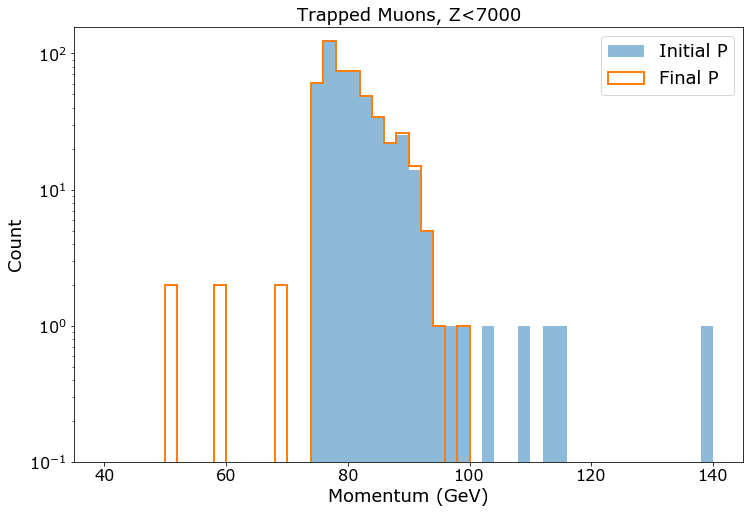

In [20]:
_ = splt.hist(df_mu.query('zstop<7000').p.values, range=(40,140), bins=50, label='Initial P', log=True)
_ = splt.hist(df_mu.query('zstop<7000').pstop.values, range=(40,140), bins=50, label='Final P', histtype='step', log=True)
plt.legend()
plt.title('Trapped Muons, Z<7000')
plt.xlabel('Momentum (GeV)')
plt.ylabel('Count')


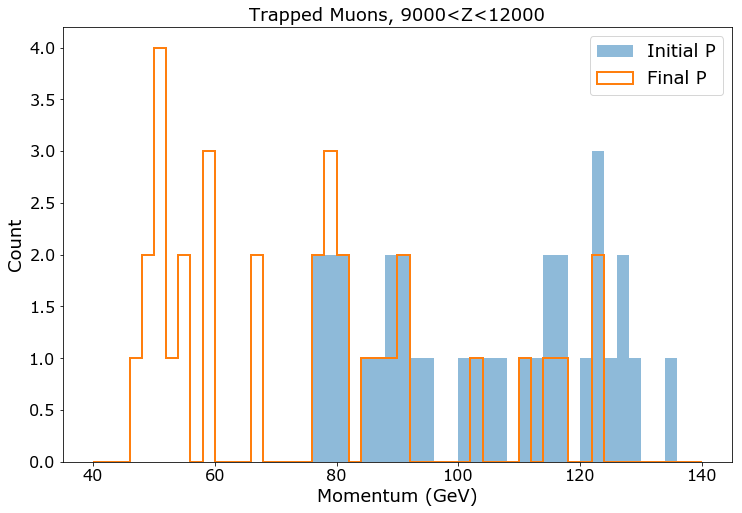

In [24]:
_ = splt.hist(df_mu.query('9000<zstop<12000').p.values, range=(40,140), bins=50, label='Initial P')
_ = splt.hist(df_mu.query('9000<zstop<12000').pstop.values, range=(40,140), bins=50, label='Final P', histtype='step')
plt.legend()
plt.title('Trapped Muons, 9000<Z<12000')
plt.xlabel('Momentum (GeV)')
plt.ylabel('Count')

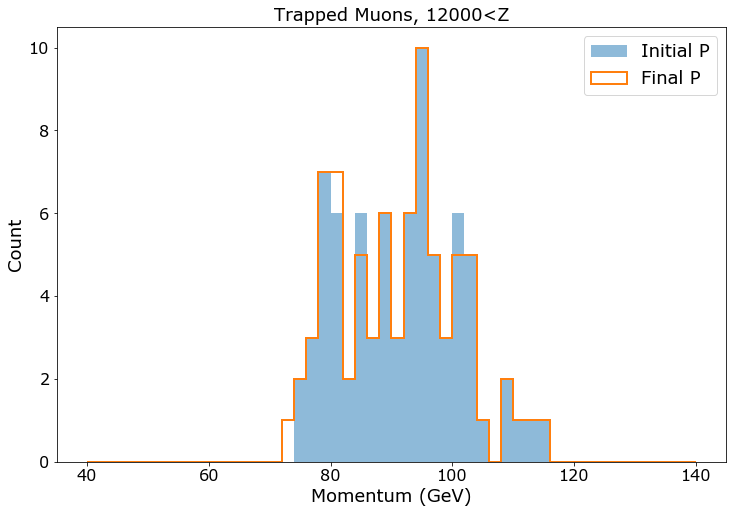

In [25]:
_ = splt.hist(df_mu.query('12000<zstop').p.values, range=(40,140), bins=50, label='Initial P')
_ = splt.hist(df_mu.query('12000<zstop').pstop.values, range=(40,140), bins=50, label='Final P', histtype='step')
plt.legend()
plt.title('Trapped Muons, 12000<Z')
plt.xlabel('Momentum (GeV)')
plt.ylabel('Count')

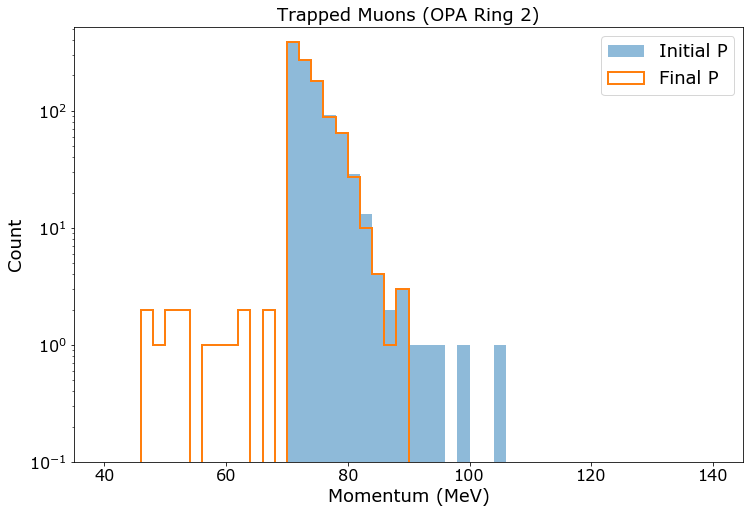

In [14]:
_ = splt.hist(df_mu_r1.query('zstop>5350').p.values, range=(40,140), bins=50, label='Initial P', log=True)
_ = splt.hist(df_mu_r1.query('zstop>5350').pstop.values, range=(40,140), bins=50, label='Final P', histtype='step', log=True)
plt.legend()
plt.title('Trapped Muons (OPA Ring 2)')
plt.xlabel('Momentum (MeV)')
plt.ylabel('Count')

# Data Munging

In [3]:
# Region 1

df_ntpart, _, _ = g4root_to_df(mu2e_data_path+'muon-r2brass-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v650p.combined',
do_basic_modifications=True, trees=['part'])
df_mu = df_ntpart.query('pdg==13 and tstop>700').reset_index()
df_mu.name = 'Muons'
df_mu.to_pickle('mau12_700ns_r2brass.p')

In [3]:
# Region 1 (finetime)

df_ntpart_ft, df_nttvd_ft, _ = g4root_to_df(mu2e_data_path+'muon-r1-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v633.finetime_r1',
do_basic_modifications=True, trees=['part', 'tvd'])

KeyboardInterrupt: 

In [4]:
# Region 2

df_ntpart, _, _ = g4root_to_df(mu2e_data_path+'muon-r2-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v633.combined_r2',
do_basic_modifications=True, trees=['part'])
df_mu = df_ntpart.query('pdg==13 and tstop>700').reset_index()
df_mu.name = 'Muons'
df_mu.to_pickle('mau12_700ns_r2.p')

In [5]:
# Region 3

df_ntpart, _, _ = g4root_to_df(mu2e_data_path+'muon-r3-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v633.combined_r3',
do_basic_modifications=True, trees=['part'])
df_mu = df_ntpart.query('pdg==13 and tstop>700').reset_index()
df_mu.name = 'Muons'
df_mu.to_pickle('mau12_700ns_r3.p')

In [2]:
# Region 2a

df_ntpart, _, _ = g4root_to_df(mu2e_data_path+'muon-r2a-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v633.combined_r2a',
do_basic_modifications=True, trees=['part'])
df_mu = df_ntpart.query('pdg==13 and tstop>700').reset_index()
df_mu.name = 'Muons'
df_mu.to_pickle('mau12_700ns_r2a.p')


In [2]:
# Region 2a (finetime)

df_ntpart_ft, df_nttvd_ft, _ = g4root_to_df(mu2e_data_path+'muon-r2a-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v633.finetime_r2a',
do_basic_modifications=True, trees=['part', 'tvd'])

In [2]:
# Region 2b

df_ntpart, _, _ = g4root_to_df(mu2e_data_path+'muon-r2b-Mau12/nts.bpollack.iso_muons_Mau12_stage1_vd.v633.combined_r2b',
do_basic_modifications=True, trees=['part'])
df_mu = df_ntpart.query('pdg==13 and tstop>700').reset_index()
df_mu.name = 'Muons'
df_mu.to_pickle('mau12_700ns_r2b.p')


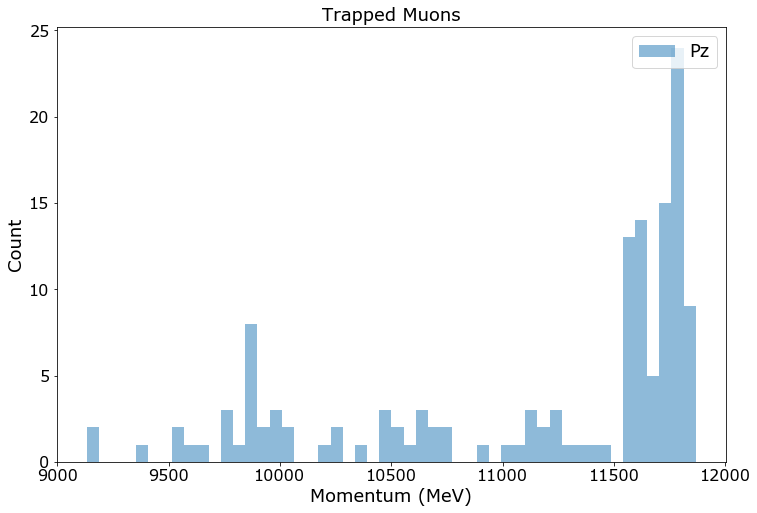

In [8]:
_ = splt.hist(df_mu_r2.pz.values, bins=50, label='Pz')
plt.legend()
plt.title('Trapped Muons')
plt.xlabel('Momentum (MeV)')
plt.ylabel('Count')

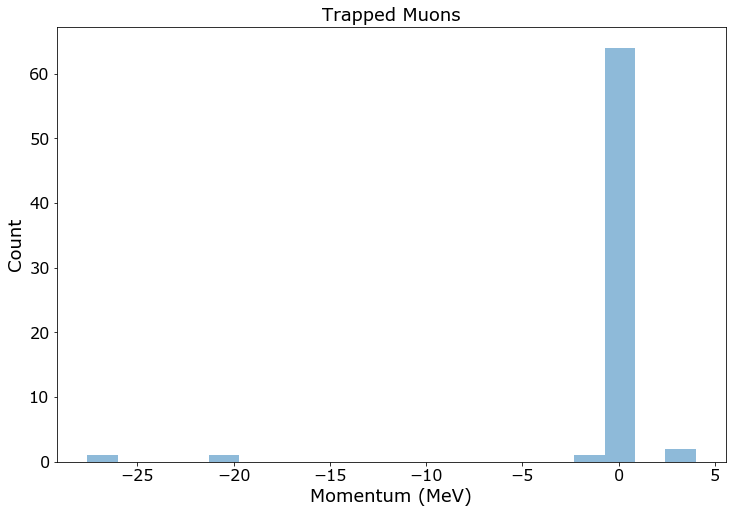

In [20]:
_ = splt.hist(df_mu_r2.query('pstop>75 and z>10700').pz.values, bins=20)
plt.legend()
plt.title('Trapped Muons')
plt.xlabel('Momentum (MeV)')
plt.ylabel('Count')

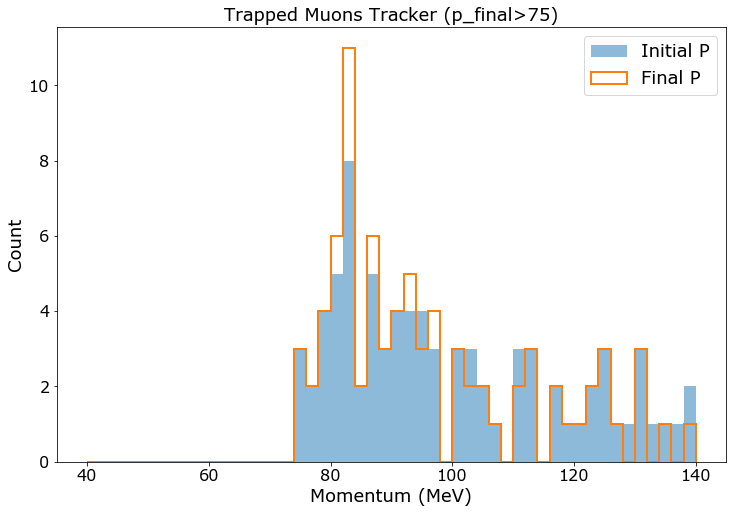

In [13]:
_ = splt.hist(df_mu_r2.query('pstop>75').p.values, range=(40,140), bins=50, label='Initial P')
_ = splt.hist(df_mu_r2.query('pstop>75').pstop.values, range=(40,140), bins=50, label='Final P', histtype='step')
plt.legend()
plt.title('Trapped Muons Tracker (p_final>75)')
plt.xlabel('Momentum (MeV)')
plt.ylabel('Count')

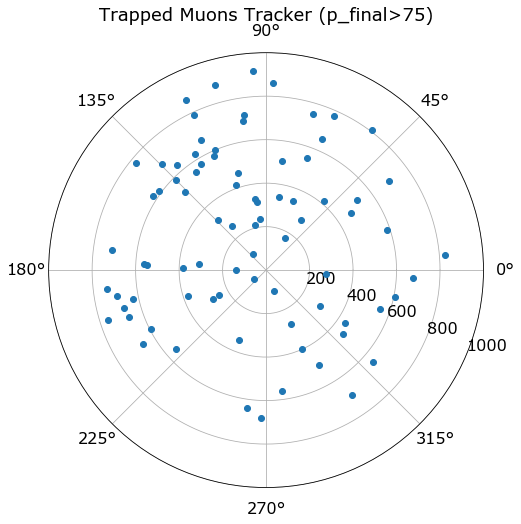

In [20]:
r2_cut = df_mu_r2.query('pstop>75')
theta = np.arctan2(r2_cut.ystop, r2_cut.xstop)
r = np.sqrt(r2_cut.ystop**2+r2_cut.xstop**2)
ax = plt.subplot(111, projection='polar')
ax.plot(theta, r, 'o')
ax.set_rmax(1000)
#ax.set_rticks([0.5, 1, 1.5, 2])  # less radial ticks
ax.set_rlabel_position(-22.5)  # get radial labels away from plotted line
ax.grid(True)

ax.set_title("Trapped Muons Tracker (p_final>75)", va='bottom')

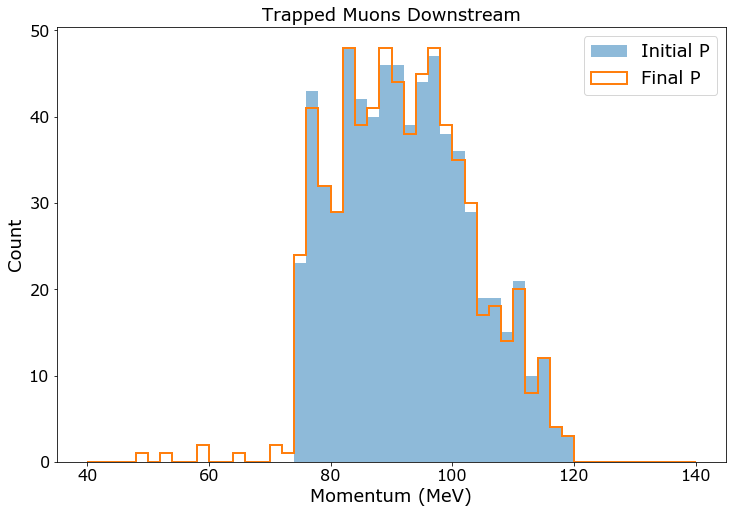

In [26]:
_ = splt.hist(df_mu_r3.p.values, range=(40,140), bins=50, label='Initial P')
_ = splt.hist(df_mu_r3.pstop.values, range=(40,140), bins=50, label='Final P', histtype='step')
plt.legend()
plt.title('Trapped Muons Downstream')
plt.xlabel('Momentum (MeV)')
plt.ylabel('Count')

In [5]:
df_ntpart_ft.query('tstop>690 and pstop>100')

,run,subrun,evt,trk,pdg,time,gtime,x,y,z,...,parent_py,parent_pz,parent_p,parent_pxstop,parent_pystop,parent_pzstop,parent_pstop,parent_code,parent_lastke,runevt
6016,1,233,40830,1,13,0.0,0.0,563.761963,-291.613464,4925.587402,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,23340830
8266,1,320,13674,1,13,0.0,0.0,662.610840,-559.511658,5095.057129,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,32013674
10005,1,388,84487,1,13,0.0,0.0,726.293457,-532.330139,4966.044922,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,38884487


In [10]:
df_ntpart_Mau12.shape

(17550, 45)

In [11]:
df_ntpart_Mau12.query('pstop>75').shape

(10023, 45)

In [12]:
df_ntpart_Mau13.query('pstop>75').shape

(795, 45)

In [14]:
10023/795

12.60754716981132